# Setup

In [1]:
# !pip install wheel
# !pip install pipwin

# !pipwin install numpy
# !pipwin install pandas
# !pipwin install shapely
# !pipwin install gdal
# !pipwin install fiona
# !pipwin install pyproj
# !pipwin install six
# !pipwin install rtree
# !pipwin install geopandas

In [2]:
# !pip install --upgrade geopandas
# !pip install --upgrade pyshp
# !pip install --upgrade shapely
# !pip install --upgrade descartes
# !pip install plotly

In [3]:
# import libraries
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px

# Geographic Data

Dateset file is `mys_admbnda_adm1_unhcr_20210211.shp`

In [4]:
gdf = gpd.read_file("mys_admb_unhcr_20210211_shp/mys_admbnda_adm1_unhcr_20210211.shp")
gdf

,Shape_Leng,Shape_Area,ADM1_EN,ADM1_PCODE,ADM1_REF,ADM1ALT1EN,ADM1ALT2EN,ADM0_EN,ADM0_PCODE,date,validOn,validTo,geometry
0,10.541451,1.556311,Johor,MY01,None,None,None,Malaysia,MY,2020-12-02,2021-02-11,None,"MULTIPOLYGON (((103.42134 1.30583, 103.42113 1..."
1,8.615689,0.777377,Kedeh,MY02,None,None,None,Malaysia,MY,2020-12-02,2021-02-11,None,"MULTIPOLYGON (((100.32889 5.66444, 100.32917 5..."
2,7.185704,1.234524,Kelantan,MY03,None,None,None,Malaysia,MY,2020-12-02,2021-02-11,None,"MULTIPOLYGON (((102.17395 6.20126, 102.17395 6..."
3,2.067451,0.134483,Melaka,MY06,None,None,None,Malaysia,MY,2020-12-02,2021-02-11,None,"MULTIPOLYGON (((102.33500 2.04833, 102.33528 2..."
4,3.620969,0.542415,Negeri,MY07,None,None,None,Malaysia,MY,2020-12-02,2021-02-11,None,"MULTIPOLYGON (((101.79472 2.51389, 101.79444 2..."
5,10.750731,2.919169,Pahang,MY08,None,None,None,Malaysia,MY,2020-12-02,2021-02-11,None,"MULTIPOLYGON (((103.45879 3.46532, 103.45823 3..."
6,11.358448,1.707114,Perak,MY09,None,None,None,Malaysia,MY,2020-12-02,2021-02-11,None,"MULTIPOLYGON (((100.10291 3.97632, 100.10300 3..."
7,1.361590,0.067320,Perlis,MY10,None,None,None,Malaysia,MY,2020-12-02,2021-02-11,None,"POLYGON ((100.12444 6.40509, 100.12567 6.40631..."
8,2.616795,0.086223,Pulau Pinang,MY11,None,None,None,Malaysia,MY,2020-12-02,2021-02-11,None,"MULTIPOLYGON (((100.17973 5.23083, 100.18000 5..."
9,38.328468,6.028039,Sabah,MY12,None,None,None,Malaysia,MY,2020-12-02,2021-02-11,None,"MULTIPOLYGON (((118.62939 4.11226, 118.62906 4..."


<AxesSubplot:>

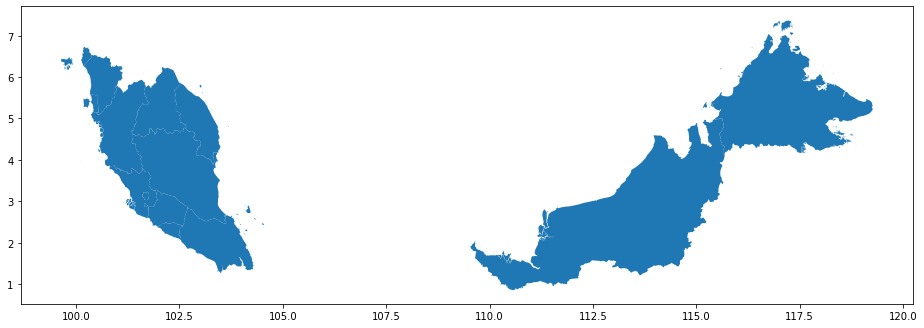

In [5]:
gdf.plot(figsize = (16,9))

In [6]:
gdf.crs # coordinate system
# SG's crs = SYP61

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

# Vaccination Data

In [7]:
# from repo
# df = pd.read_csv("https://raw.githubusercontent.com/CITF-Malaysia/citf-public/main/vaccination/vax_state.csv")

# local
df = pd.read_csv("vax_state.csv")
df

,date,state,daily_partial,daily_full,daily_booster,daily_booster2,daily,daily_partial_adol,daily_full_adol,daily_booster_adol,...,sinopharm2,sinopharm3,sinopharm4,cansino,cansino3,cansino4,pending1,pending2,pending3,pending4
0,2021-02-24,Johor,2,0,0,0,2,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,2021-02-24,Kedah,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2021-02-24,Kelantan,1,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,2021-02-24,Melaka,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,2021-02-24,Negeri Sembilan,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8539,2022-08-11,Selangor,55,117,208,1360,1740,2,14,7,...,1,0,0,0,0,0,0,0,1,5
8540,2022-08-11,Terengganu,6,42,57,57,162,2,2,0,...,0,0,0,0,0,0,0,0,0,1
8541,2022-08-11,W.P. Kuala Lumpur,46,41,109,1049,1245,3,4,7,...,0,0,0,0,0,0,0,0,1,0
8542,2022-08-11,W.P. Labuan,1,17,1,4,23,0,2,0,...,0,0,0,0,0,0,0,0,0,0


Get values for each date and state:

In [8]:
df_pivot = df.pivot(index = 'date', columns = 'state', values = 'cumul_partial')
df_pivot

state,Johor,Kedah,Kelantan,Melaka,Negeri Sembilan,Pahang,Perak,Perlis,Pulau Pinang,Sabah,Sarawak,Selangor,Terengganu,W.P. Kuala Lumpur,W.P. Labuan,W.P. Putrajaya
date,,,,,,,,,,,,,,,,
2021-02-24,2,0,1,0,0,0,0,0,0,1,1,0,0,41,0,20
2021-02-25,82,0,1,0,0,123,296,0,0,2,3,43,0,588,2,75
2021-02-26,82,6,1,259,0,896,860,156,325,14,1370,322,11,916,2,94
2021-02-27,85,42,1,275,0,2662,1102,159,331,583,5000,400,12,1142,138,100
2021-02-28,914,827,163,275,0,2762,1236,159,343,1051,8188,467,474,1292,499,101
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-07,3348845,1695966,1252454,794630,1032309,1279399,2023438,217061,1633669,2610410,2502601,5249827,935972,3247172,89584,166114
2022-08-08,3348883,1696016,1252461,794654,1032312,1279412,2023442,217065,1633672,2610415,2502612,5249872,935973,3247206,89585,166115
2022-08-09,3348915,1696081,1252484,794687,1032320,1279417,2023478,217065,1633678,2610431,2502635,5249918,935977,3247238,89585,166115


In [9]:
df_pivot.index = pd.to_datetime(df_pivot.index) # turns index into a DateTimeIndex object
df_pivot.index

DatetimeIndex(['2021-02-24', '2021-02-25', '2021-02-26', '2021-02-27',
               '2021-02-28', '2021-03-01', '2021-03-02', '2021-03-03',
               '2021-03-04', '2021-03-05',
               ...
               '2022-08-02', '2022-08-03', '2022-08-04', '2022-08-05',
               '2022-08-06', '2022-08-07', '2022-08-08', '2022-08-09',
               '2022-08-10', '2022-08-11'],
              dtype='datetime64[ns]', name='date', length=534, freq=None)

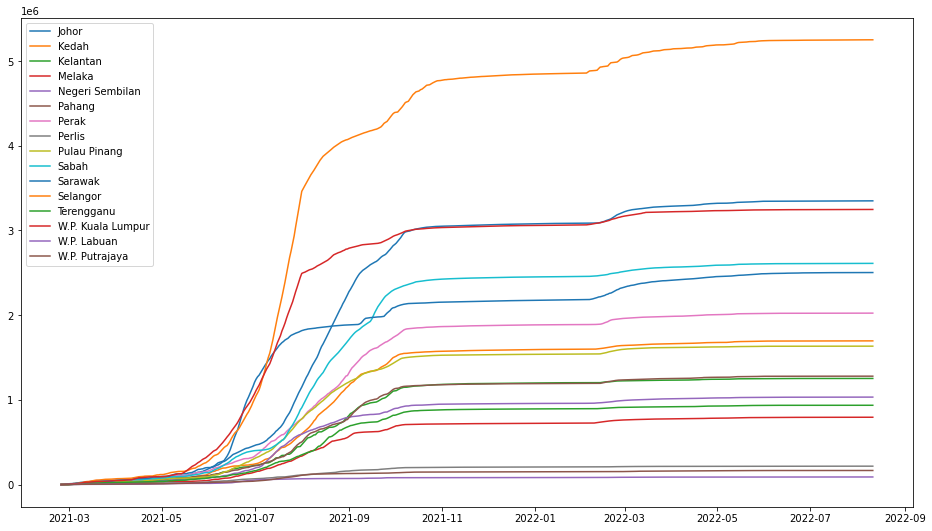

In [10]:
# plotting raw numbers
plt.figure(figsize= (16,9))
plt.plot(df_pivot)
plt.legend(df_pivot.columns)
plt.show()

# Population Data

In [11]:
# from repo
# pop_df = pd.read_csv("https://raw.githubusercontent.com/CITF-Malaysia/citf-public/main/static/population.csv")

# local
pop_df = pd.read_csv("population.csv")
pop_df

,state,idxs,pop,pop_18,pop_60
0,Malaysia,0,32657400,23409600,3502000
1,Johor,1,3781000,2711900,428700
2,Kedah,2,2185100,1540600,272500
3,Kelantan,3,1906700,1236200,194100
4,Melaka,4,932700,677400,118500
5,Negeri Sembilan,5,1128800,814400,145000
6,Pahang,6,1678700,1175800,190200
7,Pulau Pinang,7,1773600,1367200,239200
8,Perak,8,2510300,1862700,397300
9,Perlis,9,254900,181200,35100


In [12]:
# loop through each column, divide each column with population data
for state in df_pivot.columns:
    pop = pop_df[pop_df['state'] == state]['pop'].values[0]
    
    # divide column values with corresponding pop
    df_pivot[state] = df_pivot[state]/pop

df_pivot

state,Johor,Kedah,Kelantan,Melaka,Negeri Sembilan,Pahang,Perak,Perlis,Pulau Pinang,Sabah,Sarawak,Selangor,Terengganu,W.P. Kuala Lumpur,W.P. Labuan,W.P. Putrajaya
date,,,,,,,,,,,,,,,,
2021-02-24,5.289606e-07,0.000000,5.244664e-07,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.558526e-07,3.550506e-07,0.000000,0.000000,0.000023,0.000000,0.000182
2021-02-25,2.168738e-05,0.000000,5.244664e-07,0.000000,0.000000,0.000073,0.000118,0.000000,0.000000,5.117053e-07,1.065152e-06,0.000007,0.000000,0.000332,0.000020,0.000682
2021-02-26,2.168738e-05,0.000003,5.244664e-07,0.000278,0.000000,0.000534,0.000343,0.000612,0.000183,3.581937e-06,4.864193e-04,0.000049,0.000009,0.000516,0.000020,0.000855
2021-02-27,2.248083e-05,0.000019,5.244664e-07,0.000295,0.000000,0.001586,0.000439,0.000624,0.000187,1.491621e-04,1.775253e-03,0.000061,0.000010,0.000644,0.001386,0.000909
2021-02-28,2.417350e-04,0.000378,8.548802e-05,0.000295,0.000000,0.001645,0.000492,0.000624,0.000193,2.689011e-04,2.907154e-03,0.000071,0.000376,0.000728,0.005010,0.000918
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-07,8.857035e-01,0.776150,6.568700e-01,0.851967,0.914519,0.762137,0.806054,0.851554,0.921103,6.678803e-01,8.885500e-01,0.802971,0.743248,1.830733,0.899438,1.510127
2022-08-08,8.857136e-01,0.776173,6.568737e-01,0.851993,0.914522,0.762145,0.806056,0.851569,0.921105,6.678815e-01,8.885539e-01,0.802978,0.743249,1.830753,0.899448,1.510136
2022-08-09,8.857220e-01,0.776203,6.568857e-01,0.852029,0.914529,0.762147,0.806070,0.851569,0.921108,6.678856e-01,8.885620e-01,0.802985,0.743252,1.830771,0.899448,1.510136


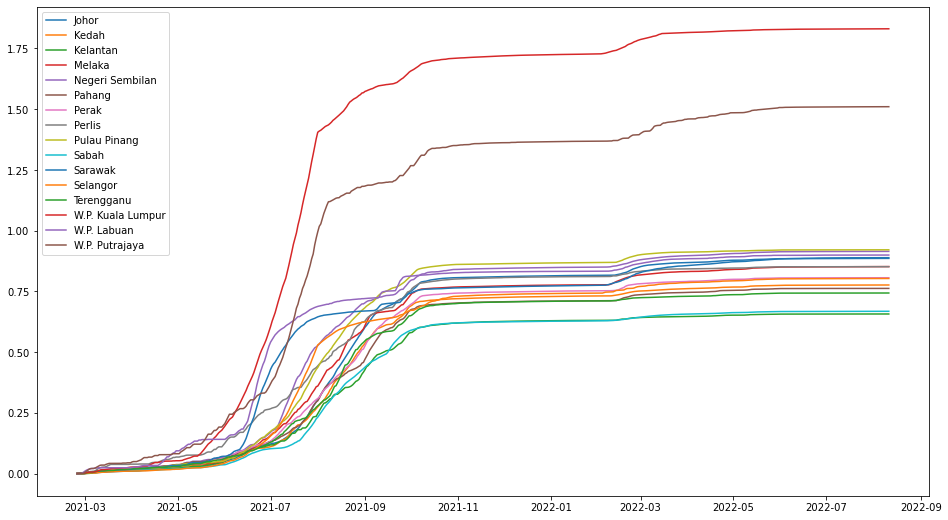

In [13]:
# max upper bound = 2
plt.figure(figsize= (16,9))
plt.plot(df_pivot)
plt.legend(df_pivot.columns)
plt.show()

# Geographic + Vaccination

Before merging both DataFrames, check that they have a common set of state names:

In [14]:
gdf['ADM1_EN'].value_counts().sort_index()

Johor                1
Kedeh                1
Kelantan             1
Melaka               1
Negeri               1
Pahang               1
Perak                1
Perlis               1
Pulau Pinang         1
Sabah                1
Sarawak              1
Selangor             1
Terengganu           1
W.P. Kuala Lumpur    1
W.P. Labuan          1
W.P. Putrajaya       1
Name: ADM1_EN, dtype: int64

In [15]:
df['state'].value_counts().sort_index()

Johor                534
Kedah                534
Kelantan             534
Melaka               534
Negeri Sembilan      534
Pahang               534
Perak                534
Perlis               534
Pulau Pinang         534
Sabah                534
Sarawak              534
Selangor             534
Terengganu           534
W.P. Kuala Lumpur    534
W.P. Labuan          534
W.P. Putrajaya       534
Name: state, dtype: int64

Rename to common state names of both `gdf` and `df`:

In [16]:
gdf['ADM1_EN'] = gdf['ADM1_EN'].replace(['Kedeh', 'Negeri'], ['Kedah', 'Negeri Sembilan'])
gdf['ADM1_EN']

0                 Johor
1                 Kedah
2              Kelantan
3                Melaka
4       Negeri Sembilan
5                Pahang
6                 Perak
7                Perlis
8          Pulau Pinang
9                 Sabah
10              Sarawak
11             Selangor
12           Terengganu
13    W.P. Kuala Lumpur
14          W.P. Labuan
15       W.P. Putrajaya
Name: ADM1_EN, dtype: object

# Plot Combined Data for Latest Date

Take only the latest data:

In [17]:
latest_date = df['date'].max()

latest_df = df[df['date'] == latest_date]
latest_df

,date,state,daily_partial,daily_full,daily_booster,daily_booster2,daily,daily_partial_adol,daily_full_adol,daily_booster_adol,...,sinopharm2,sinopharm3,sinopharm4,cansino,cansino3,cansino4,pending1,pending2,pending3,pending4
8528,2022-08-11,Johor,34,105,266,696,1101,3,13,7,...,0,4,0,0,0,0,0,0,0,0
8529,2022-08-11,Kedah,31,191,151,174,547,4,18,1,...,0,0,0,0,0,0,0,0,0,0
8530,2022-08-11,Kelantan,8,115,92,23,238,1,8,1,...,0,0,0,0,0,0,0,0,0,0
8531,2022-08-11,Melaka,2,15,28,99,144,0,0,2,...,0,1,0,0,0,0,0,0,0,0
8532,2022-08-11,Negeri Sembilan,9,32,45,285,371,1,2,0,...,0,0,0,0,0,0,0,0,0,0
8533,2022-08-11,Pahang,1,18,31,111,161,0,4,2,...,0,0,0,0,0,0,0,0,0,0
8534,2022-08-11,Perak,10,66,81,304,461,2,5,1,...,0,0,0,0,0,0,0,0,0,0
8535,2022-08-11,Perlis,3,4,17,4,28,0,0,0,...,0,0,0,0,0,0,0,0,0,0
8536,2022-08-11,Pulau Pinang,11,35,38,145,229,1,3,1,...,0,0,0,0,0,0,0,0,0,0
8537,2022-08-11,Sabah,8,262,61,204,535,0,4,0,...,0,0,0,187,0,0,0,0,0,0


Combine geographic DataFrame with vaccination data on latest date:

<AxesSubplot:>

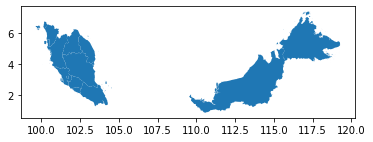

In [18]:
merged = pd.merge(gdf, latest_df, left_on='ADM1_EN', right_on='state')
merged.plot()

<AxesSubplot:>

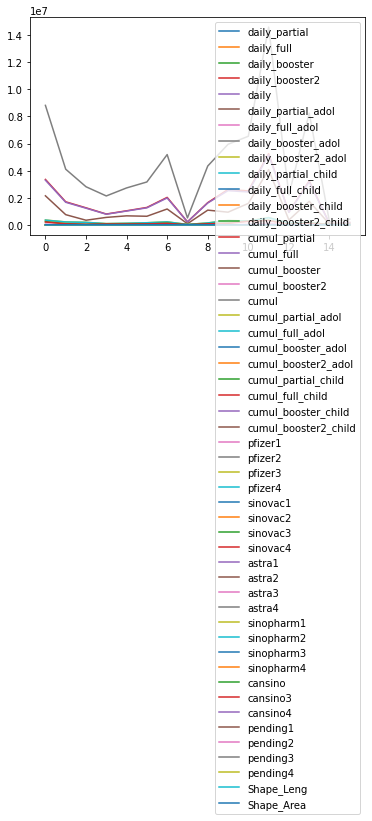

In [19]:
# bad example when orders are reversed
# geometry numbers should come first
pd.merge(latest_df, gdf, right_on='ADM1_EN', left_on='state').plot()

Keep only relevant columns:

In [20]:
merged.columns

Index(['Shape_Leng', 'Shape_Area', 'ADM1_EN', 'ADM1_PCODE', 'ADM1_REF',
       'ADM1ALT1EN', 'ADM1ALT2EN', 'ADM0_EN', 'ADM0_PCODE', 'date_x',
       'validOn', 'validTo', 'geometry', 'date_y', 'state', 'daily_partial',
       'daily_full', 'daily_booster', 'daily_booster2', 'daily',
       'daily_partial_adol', 'daily_full_adol', 'daily_booster_adol',
       'daily_booster2_adol', 'daily_partial_child', 'daily_full_child',
       'daily_booster_child', 'daily_booster2_child', 'cumul_partial',
       'cumul_full', 'cumul_booster', 'cumul_booster2', 'cumul',
       'cumul_partial_adol', 'cumul_full_adol', 'cumul_booster_adol',
       'cumul_booster2_adol', 'cumul_partial_child', 'cumul_full_child',
       'cumul_booster_child', 'cumul_booster2_child', 'pfizer1', 'pfizer2',
       'pfizer3', 'pfizer4', 'sinovac1', 'sinovac2', 'sinovac3', 'sinovac4',
       'astra1', 'astra2', 'astra3', 'astra4', 'sinopharm1', 'sinopharm2',
       'sinopharm3', 'sinopharm4', 'cansino', 'cansino3', 'cansino

In [21]:
cols_to_keep = ['geometry', 'date_y', 'state', 'cumul_partial']

merged = merged[cols_to_keep]
merged

,geometry,date_y,state,cumul_partial
0,"MULTIPOLYGON (((103.42134 1.30583, 103.42113 1...",2022-08-11,Johor,3348978
1,"MULTIPOLYGON (((100.32889 5.66444, 100.32917 5...",2022-08-11,Kedah,1696126
2,"MULTIPOLYGON (((102.17395 6.20126, 102.17395 6...",2022-08-11,Kelantan,1252499
3,"MULTIPOLYGON (((102.33500 2.04833, 102.33528 2...",2022-08-11,Melaka,794691
4,"MULTIPOLYGON (((101.79472 2.51389, 101.79444 2...",2022-08-11,Negeri Sembilan,1032336
5,"MULTIPOLYGON (((103.45879 3.46532, 103.45823 3...",2022-08-11,Pahang,1279418
6,"MULTIPOLYGON (((100.10291 3.97632, 100.10300 3...",2022-08-11,Perak,2023498
7,"POLYGON ((100.12444 6.40509, 100.12567 6.40631...",2022-08-11,Perlis,217068
8,"MULTIPOLYGON (((100.17973 5.23083, 100.18000 5...",2022-08-11,Pulau Pinang,1633691
9,"MULTIPOLYGON (((118.62939 4.11226, 118.62906 4...",2022-08-11,Sabah,2610900


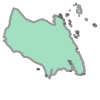

In [22]:
merged['geometry'][0]

In [23]:
# to see coordinates
print(merged['geometry'][0])

MULTIPOLYGON (((103.42134094300008 1.3058320280000544, 103.42112732000004 1.3056199550000542, 103.42089843700006 1.305673003000038, 103.42057800300006 1.3058710090000432, 103.42021179200003 1.3061310050000543, 103.41983032200005 1.3063859940000384, 103.41947937000003 1.3066389560000289, 103.41916656500007 1.306910038000069, 103.41887664800004 1.307229042000074, 103.41857910100003 1.3076009750000708, 103.41819763200004 1.3079860210000334, 103.41801452600004 1.3083100320000653, 103.41793060300006 1.3093030450000356, 103.41804504400005 1.3097020380000686, 103.41805267300003 1.3101149790000477, 103.41800689700005 1.3105109930000367, 103.41780853300008 1.3108509780000759, 103.41765594500004 1.3112289900000746, 103.41758728000008 1.311701059000029, 103.41767883300008 1.312250018000043, 103.41754150400004 1.3128310440000632, 103.41745758100006 1.3134310240000673, 103.41723632800006 1.3139569760000427, 103.41704559300007 1.314475059000074, 103.41695404100005 1.3149900440000692, 103.41699218800

Set the states as the index of the merged DataFrame:

In [24]:
merged.index = merged['state']
merged

,geometry,date_y,state,cumul_partial
state,,,,
Johor,"MULTIPOLYGON (((103.42134 1.30583, 103.42113 1...",2022-08-11,Johor,3348978
Kedah,"MULTIPOLYGON (((100.32889 5.66444, 100.32917 5...",2022-08-11,Kedah,1696126
Kelantan,"MULTIPOLYGON (((102.17395 6.20126, 102.17395 6...",2022-08-11,Kelantan,1252499
Melaka,"MULTIPOLYGON (((102.33500 2.04833, 102.33528 2...",2022-08-11,Melaka,794691
Negeri Sembilan,"MULTIPOLYGON (((101.79472 2.51389, 101.79444 2...",2022-08-11,Negeri Sembilan,1032336
Pahang,"MULTIPOLYGON (((103.45879 3.46532, 103.45823 3...",2022-08-11,Pahang,1279418
Perak,"MULTIPOLYGON (((100.10291 3.97632, 100.10300 3...",2022-08-11,Perak,2023498
Perlis,"POLYGON ((100.12444 6.40509, 100.12567 6.40631...",2022-08-11,Perlis,217068
Pulau Pinang,"MULTIPOLYGON (((100.17973 5.23083, 100.18000 5...",2022-08-11,Pulau Pinang,1633691


Retain only `geometry` column:

In [25]:
merged_geometry = merged[['geometry']] # double brackets for df
merged_geometry

,geometry
state,
Johor,"MULTIPOLYGON (((103.42134 1.30583, 103.42113 1..."
Kedah,"MULTIPOLYGON (((100.32889 5.66444, 100.32917 5..."
Kelantan,"MULTIPOLYGON (((102.17395 6.20126, 102.17395 6..."
Melaka,"MULTIPOLYGON (((102.33500 2.04833, 102.33528 2..."
Negeri Sembilan,"MULTIPOLYGON (((101.79472 2.51389, 101.79444 2..."
Pahang,"MULTIPOLYGON (((103.45879 3.46532, 103.45823 3..."
Perak,"MULTIPOLYGON (((100.10291 3.97632, 100.10300 3..."
Perlis,"POLYGON ((100.12444 6.40509, 100.12567 6.40631..."
Pulau Pinang,"MULTIPOLYGON (((100.17973 5.23083, 100.18000 5..."


In [26]:
merged_geojson = merged_geometry.__geo_interface__
merged_geojson

{'type': 'FeatureCollection',
 'features': [{'id': 'Johor',
   'type': 'Feature',
   'properties': {},
   'geometry': {'type': 'MultiPolygon',
    'coordinates': [(((103.42134094300008, 1.3058320280000544),
       (103.42112732000004, 1.3056199550000542),
       (103.42089843700006, 1.305673003000038),
       (103.42057800300006, 1.3058710090000432),
       (103.42021179200003, 1.3061310050000543),
       (103.41983032200005, 1.3063859940000384),
       (103.41947937000003, 1.3066389560000289),
       (103.41916656500007, 1.306910038000069),
       (103.41887664800004, 1.307229042000074),
       (103.41857910100003, 1.3076009750000708),
       (103.41819763200004, 1.3079860210000334),
       (103.41801452600004, 1.3083100320000653),
       (103.41793060300006, 1.3093030450000356),
       (103.41804504400005, 1.3097020380000686),
       (103.41805267300003, 1.3101149790000477),
       (103.41800689700005, 1.3105109930000367),
       (103.41780853300008, 1.3108509780000759),
       (103.

In [27]:
fig = px.choropleth_mapbox(data_frame = merged,
                           geojson = merged_geojson,
                           locations = merged['state'],
                           color = 'cumul_partial',
                           range_color = (0, max(merged['cumul_partial'])),
                           mapbox_style = 'open-street-map',
                           center = dict(lon = 101.73227, lat = 3.03781), # centers map display on KL
                           zoom = 5)

fig.show()

In [28]:
# fig = px.choropleth_mapbox(data_frame= merged,
#                            geojson = merged_geojson,
#                            locations = merged['state'],
#                            color = 'total_cumul',
#                            range_color = (0, max(merged['total_cumul'])),
#                            mapbox_style = 'open-street-map',
#                            # center = dict(lon = 101.73227, lat = 3.03781), # KL
#                            zoom = 5)

# #  renderer needed if running on colab
# fig.show(renderer = 'colab')

## Scale Out to all Dates (Month-Year)

In [29]:
df_time = df.copy()
df_time['date']

0       2021-02-24
1       2021-02-24
2       2021-02-24
3       2021-02-24
4       2021-02-24
           ...    
8539    2022-08-11
8540    2022-08-11
8541    2022-08-11
8542    2022-08-11
8543    2022-08-11
Name: date, Length: 8544, dtype: object

In [30]:
# convert to datetime
df_time['date'] = pd.to_datetime(df_time['date'])
df_time['date']

0      2021-02-24
1      2021-02-24
2      2021-02-24
3      2021-02-24
4      2021-02-24
          ...    
8539   2022-08-11
8540   2022-08-11
8541   2022-08-11
8542   2022-08-11
8543   2022-08-11
Name: date, Length: 8544, dtype: datetime64[ns]

Display only year and month:

In [31]:
df_time['date'] = df_time['date'].dt.strftime("%Y-%m")
df_time

,date,state,daily_partial,daily_full,daily_booster,daily_booster2,daily,daily_partial_adol,daily_full_adol,daily_booster_adol,...,sinopharm2,sinopharm3,sinopharm4,cansino,cansino3,cansino4,pending1,pending2,pending3,pending4
0,2021-02,Johor,2,0,0,0,2,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,2021-02,Kedah,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2021-02,Kelantan,1,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,2021-02,Melaka,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,2021-02,Negeri Sembilan,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8539,2022-08,Selangor,55,117,208,1360,1740,2,14,7,...,1,0,0,0,0,0,0,0,1,5
8540,2022-08,Terengganu,6,42,57,57,162,2,2,0,...,0,0,0,0,0,0,0,0,0,1
8541,2022-08,W.P. Kuala Lumpur,46,41,109,1049,1245,3,4,7,...,0,0,0,0,0,0,0,0,1,0
8542,2022-08,W.P. Labuan,1,17,1,4,23,0,2,0,...,0,0,0,0,0,0,0,0,0,0


Group dataset by `date` and `state`:

In [32]:
# df_time_state = df_time.groupby(['date', 'state']).agg({'cumul_partial': 'max'})
# or
df_time_state = df_time.groupby(['date', 'state']).max()[['cumul_partial']]
df_time_state

cumul_partial
date    state                           
2021-02 Johor                        914
        Kedah                        827
        Kelantan                     163
        Melaka                       275
        Negeri Sembilan                0
...                                  ...
2022-08 Selangor                 5250006
        Terengganu                935984
        W.P. Kuala Lumpur        3247318
        W.P. Labuan                89588
        W.P. Putrajaya            166116

[304 rows x 1 columns]

Convert `date` back to normal column:

In [33]:
df_time_state = df_time_state.reset_index()
df_time_state

,date,state,cumul_partial
0,2021-02,Johor,914
1,2021-02,Kedah,827
2,2021-02,Kelantan,163
3,2021-02,Melaka,275
4,2021-02,Negeri Sembilan,0
...,...,...,...
299,2022-08,Selangor,5250006
300,2022-08,Terengganu,935984
301,2022-08,W.P. Kuala Lumpur,3247318
302,2022-08,W.P. Labuan,89588


Get a list of every month-year period in dataset:

In [34]:
dates = df_time_state['date'].unique()
dates

array(['2021-02', '2021-03', '2021-04', '2021-05', '2021-06', '2021-07',
       '2021-08', '2021-09', '2021-10', '2021-11', '2021-12', '2022-01',
       '2022-02', '2022-03', '2022-04', '2022-05', '2022-06', '2022-07',
       '2022-08'], dtype=object)

In [35]:
merged_final = [] # list to store each month's values

for date in dates: # loop through the months
    temp_date_df = df_time_state[df_time_state['date'] == date] # filter for current date
    temp_merged = pd.merge(gdf, temp_date_df, right_on='state', left_on='ADM1_EN') # merge 2 dfs together
    temp_merged = temp_merged[cols_to_keep] # select columns to keep
    temp_merged.index = temp_merged['state'] # turn index into 'state'
    merged_final.append(temp_merged) # add current month's df into list

merged_final

[                                                            geometry   date_y  \
 state                                                                           
 Johor              MULTIPOLYGON (((103.42134 1.30583, 103.42113 1...  2021-02   
 Kedah              MULTIPOLYGON (((100.32889 5.66444, 100.32917 5...  2021-02   
 Kelantan           MULTIPOLYGON (((102.17395 6.20126, 102.17395 6...  2021-02   
 Melaka             MULTIPOLYGON (((102.33500 2.04833, 102.33528 2...  2021-02   
 Negeri Sembilan    MULTIPOLYGON (((101.79472 2.51389, 101.79444 2...  2021-02   
 Pahang             MULTIPOLYGON (((103.45879 3.46532, 103.45823 3...  2021-02   
 Perak              MULTIPOLYGON (((100.10291 3.97632, 100.10300 3...  2021-02   
 Perlis             POLYGON ((100.12444 6.40509, 100.12567 6.40631...  2021-02   
 Pulau Pinang       MULTIPOLYGON (((100.17973 5.23083, 100.18000 5...  2021-02   
 Sabah              MULTIPOLYGON (((118.62939 4.11226, 118.62906 4...  2021-02   
 Sarawak        

Combine list of DataFrames into a single DataFrame:

In [36]:
df_merged_final = pd.concat(merged_final)
df_merged_final

,geometry,date_y,state,cumul_partial
state,,,,
Johor,"MULTIPOLYGON (((103.42134 1.30583, 103.42113 1...",2021-02,Johor,914
Kedah,"MULTIPOLYGON (((100.32889 5.66444, 100.32917 5...",2021-02,Kedah,827
Kelantan,"MULTIPOLYGON (((102.17395 6.20126, 102.17395 6...",2021-02,Kelantan,163
Melaka,"MULTIPOLYGON (((102.33500 2.04833, 102.33528 2...",2021-02,Melaka,275
Negeri Sembilan,"MULTIPOLYGON (((101.79472 2.51389, 101.79444 2...",2021-02,Negeri Sembilan,0
...,...,...,...,...
Selangor,"MULTIPOLYGON (((101.23987 2.90329, 101.23897 2...",2022-08,Selangor,5250006
Terengganu,"MULTIPOLYGON (((103.68072 4.81510, 103.68073 4...",2022-08,Terengganu,935984
W.P. Kuala Lumpur,"POLYGON ((101.73227 3.03781, 101.70284 3.03007...",2022-08,W.P. Kuala Lumpur,3247318


In [37]:
# warning: this cell will make this notebook very large (~483MB)

# fig_2 = px.choropleth_mapbox(data_frame= df_merged_final,
#                            geojson = merged_geojson,
#                            locations = df_merged_final['state'],
#                            color = 'cumul_partial',
#                            range_color = (0, max(df_merged_final['cumul_partial'])),
#                            mapbox_style = 'open-street-map',
#                            center = dict(lon = 101.73227, lat = 3.03781), # KL
#                            zoom = 5,
#                            animation_frame = 'date_y')

# fig_2.show()

# Save Output as HTML

In [38]:
# fig_2.write_html("output.html")